# Introduction
State notebook purpose here

### Imports
Import libraries and write settings here.

In [1]:
# Notebooks specific imports
from IPython import get_ipython
ipython = get_ipython()
#Expand notebook display

from IPython.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))
# Display all cell outputs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
# autoreload extension
if 'autoreload' not in ipython.extension_manager.loaded:
    %load_ext autoreload
%autoreload 2
from tqdm.notebook import tqdm

# Basic useful imports
import re
import time
import yaml
from pprint import pprint
from pathlib import Path
import h5py
import warnings

# Data manipulation
import numpy as np
from scipy.special import erf
from scipy.integrate import quad
import scipy.stats as stats
from scipy.signal import savgol_filter
from scipy.spatial import ConvexHull

# Visualization
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D
from matplotlib.patches import (Circle, RegularPolygon, FancyArrowPatch, ArrowStyle)
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator, NullFormatter)
import matplotlib.colors as mcolors

# Clustering stuff
from sklearn.cluster import MeanShift, estimate_bandwidth, DBSCAN, OPTICS
from itertools import cycle
# plt.cm.tab20.colors

# From alens_analysis.py
import alens_analysis as aa
import alens_analysis.chromatin as aac
import alens_analysis.chromatin.chrom_analysis as ca
import alens_analysis.chromatin.chrom_condensate_analysis as cca
import alens_analysis.chromatin.chrom_graph_funcs as cgf
from alens_analysis import cluster_analysis as cla

from alens_analysis.colormaps import register_cmaps

# Locations
ws_path = Path('/home/alamson/DATA/Chromatin/')
mnt_path = Path.home() / 'projects/DATA/Chromatin/'
ceph_path = Path.home() / 'ceph/DATA/Chromatin/'

### Style settings

In [2]:
graph_sty = {
    "axes.titlesize": 20,
    "axes.labelsize": 24,
    "lines.linewidth": 2,
    "lines.markersize": 2,
    "xtick.labelsize": 24,
    "ytick.labelsize": 24,
    "font.size": 20,
    "font.sans-serif": 'Helvetica',
    "text.usetex": False,
    'mathtext.fontset': 'cm',
}
plt.style.use(graph_sty)

colors = cycle(mcolors.XKCD_COLORS.keys())
# mcolors.__dict__
# colors = cycle("bgrcmykbgrcmykbgrcmykbgrcmyk")

register_cmaps()
#plt.rcParams['image.cmap'] = 'emct8'
#plt.rcParams['image.cmap'] = 'warm'
plt.rcParams['image.cmap'] = 'YlOrRd'
#plt.rcParams['image.cmap'] = 'twilight'
#plt.rcParams['image.cmap'] = 'coolwarm'
#plt.rcParams['image.cmap'] = 'RdYlBu_r'
        

### General graphing functions

In [3]:
cluster_similarity_threshold = .4 
nskip = 10 # Time snapshot skips for cluster finding. = 10 secs
vmax = 40 # Max colorbar value in kymographs
tree_length = 30 # min length of a cluster tree in time snapshots. = 15 sec

# 2 Condensate merging

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


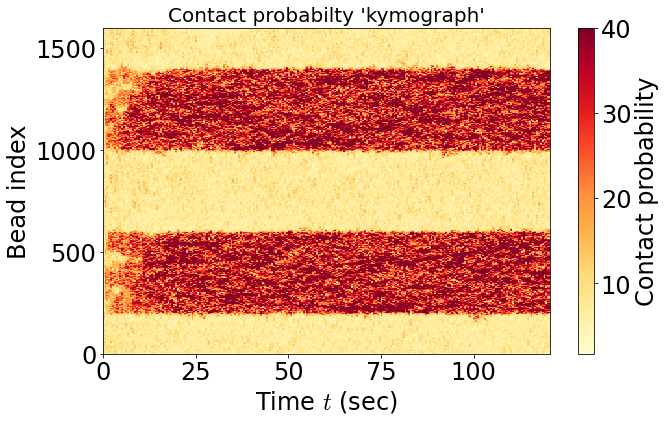

In [5]:
h5_contact_file = ceph_path / "DynCondPaper/24-01-22_aLc1_line1600_Pin3um_Ke30_ks100_2patch/analysis/contact_analysis.h5"

fig, axarr = plt.subplots(1,1, figsize=(10, 6))
_ = axarr.set_ylim(0, 1600)

with h5py.File(h5_contact_file, 'r') as h5_data:
    time_arr = h5_data['time'][...]
    contact_kymo = h5_data['contact_kymo'][...]
    
    cgf.plot_contact_kymo(fig, axarr, time_arr, contact_kymo, vmax=vmax)



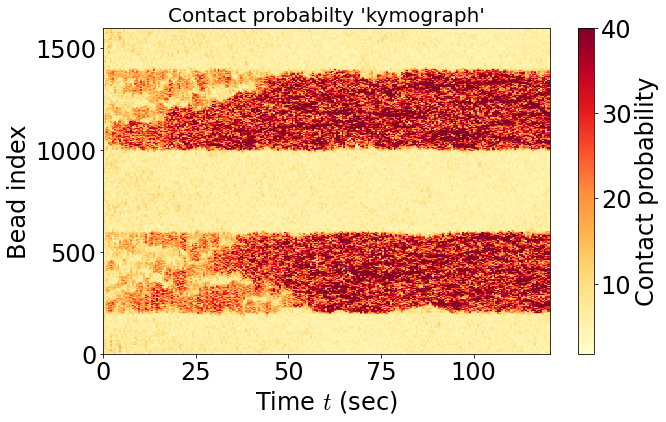

In [6]:
h5_contact_file = ceph_path / "DynCondPaper/24-01-22_aLc1_line1600_Pin5um_Ke30_ks100_2patch/analysis/contact_analysis.h5"

fig, axarr = plt.subplots(1,1, figsize=(10, 6))
_ = axarr.set_ylim(0, 1600)

with h5py.File(h5_contact_file, 'r') as h5_data:
    time_arr = h5_data['time'][...]
    contact_kymo = h5_data['contact_kymo'][...]
    
    cgf.plot_contact_kymo(fig, axarr, time_arr, contact_kymo, vmax=vmax)



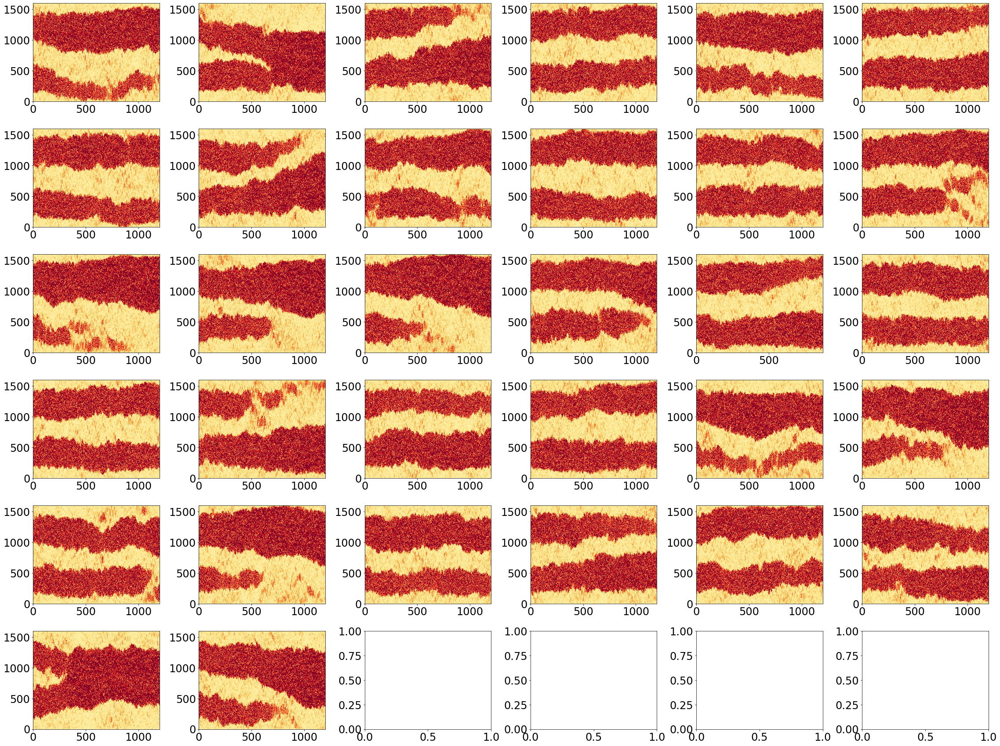

In [10]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin3um_Ke30_ks100_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))

graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()

Ok this is good. I can see that merging and unwinding events taking place here. And just like before most do not end with any kind of event. I'll submit these for longer and see if I can get better statistics.


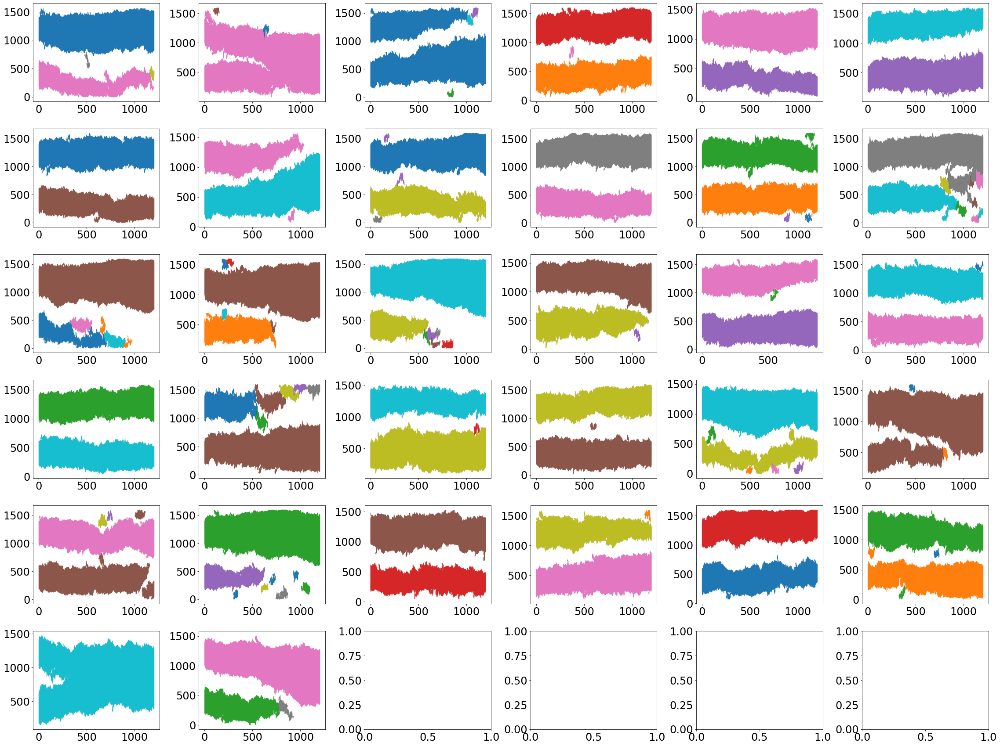

In [9]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin3um_Ke30_ks100_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/cluster_analysis.h5'))

large_tree_length = 100

merge_events = 0
dissovle_events = 0
nothing_events = 0

tableau10_colors = iter(cycle(plt.cm.tab10.colors))

graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length+j], 'r') as h5_data:
                cluster_grp = h5_data['clusters']
                time_arr = h5_data['time'][...]
                time_grp_list = sorted(cluster_grp.values(), key=lambda x: x.attrs['time'])
                clusters = []
                for tg in time_grp_list:
                    clusters += [[cla.Cluster(h5_data = c) for c in tg.values()]]

            # Cluster tree
            root_clusters = cla.find_descendants(clusters, thresh=cluster_similarity_threshold, nskip=nskip)

            trees = []
            tree_id_gen = aa.helpers.gen_id()
            for root in root_clusters:
                tree = cla.ClusterTree(next(tree_id_gen))
                tree.add_recursive(root)
                trees += [tree]


            # Graph all clusters
            for tree, color in zip(trees, tableau10_colors):
                if len(tree.clusters) < large_tree_length:
                    continue
                for clust in tree.clusters:
                    _ = axarr[i,j].plot([clust.time]*len(clust.part_ids), clust.part_ids, color = color, markersize= .1, marker='.', linestyle='None')
        except:
            raise

fig.tight_layout()




In [ ]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin3um_Ke30_ks100_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/cluster_analysis.h5'))

merge_events = 0
dissovle_events = 0
nothing_events = 0

tableau10_colors = iter(cycle(plt.cm.tab10.colors))

graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length+j], 'r') as h5_data:
                ax = axarr[i*graph_side_length+j]
                cluster_grp = h5_data['clusters']
                time_arr = h5_data['time'][...]
                time_grp_list = sorted(cluster_grp.values(), key=lambda x: x.attrs['time'])
                clusters = []
                for tg in time_grp_list:
                    clusters += [[cla.Cluster(h5_data = c) for c in tg.values()]]

            # Cluster tree
            root_clusters = cla.find_descendants(clusters, thresh=cluster_similarity_threshold, nskip=nskip)

            trees = []
            tree_id_gen = aa.helpers.gen_id()
            for root in root_clusters:
                tree = cla.ClusterTree(next(tree_id_gen))
                tree.add_recursive(root)
                trees += [tree]


            # Graph all clusters
            for tree, color in zip(trees, tableau10_colors):
                if len(tree.clusters) < tree_length:
                    continue
                for clust in tree.clusters:
                    _ = ax.plot([clust.time]*len(clust.part_ids), clust.part_ids, color = color, markersize= .1, marker='.', linestyle='None')
        except:
            pass

fig.tight_layout()




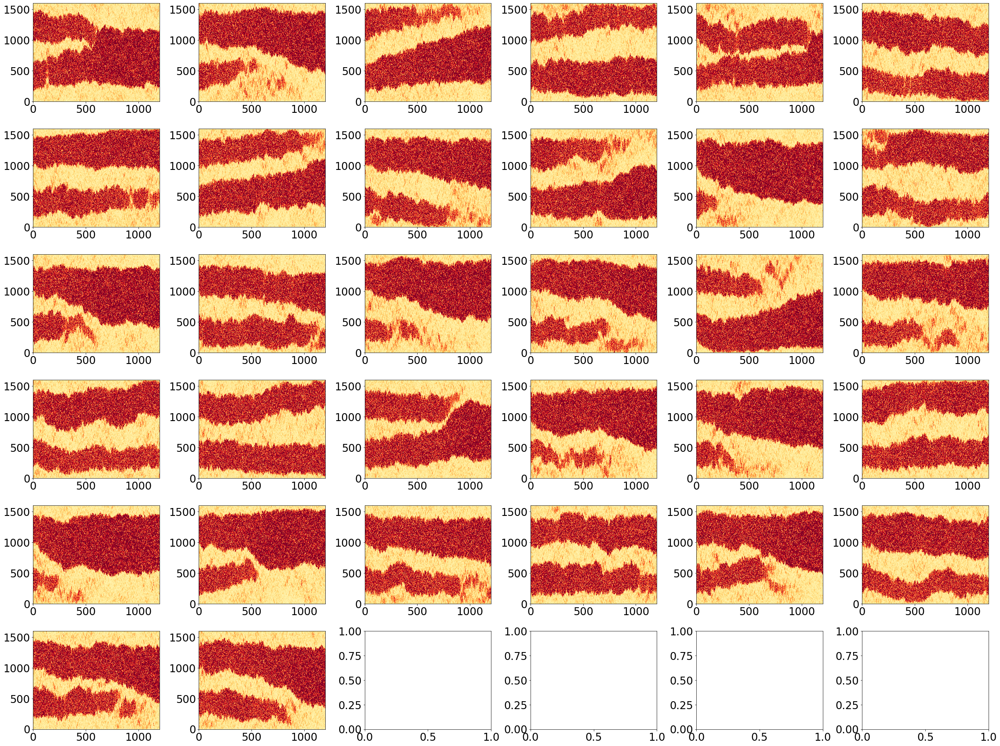

In [13]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin3um_Ke30_kod300_ks100_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))
graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()

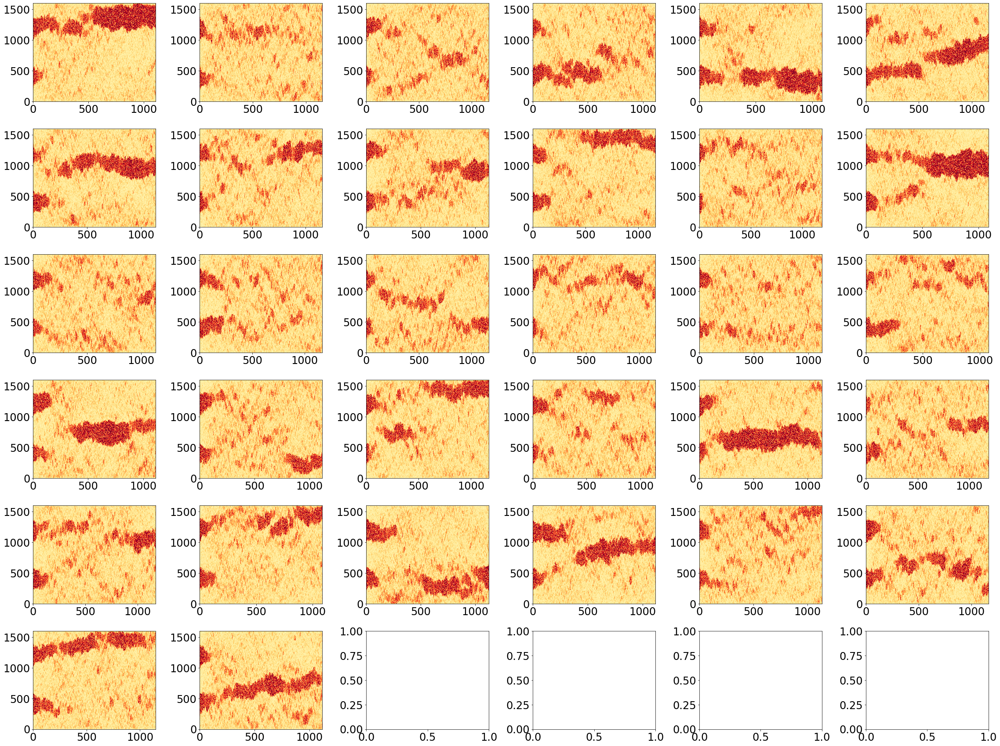

In [7]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin5um_Ke30_ks100_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))
graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()

Yeah, very transient condensates going on here. This is right on the edge of the phase diagram which is a good analysis.

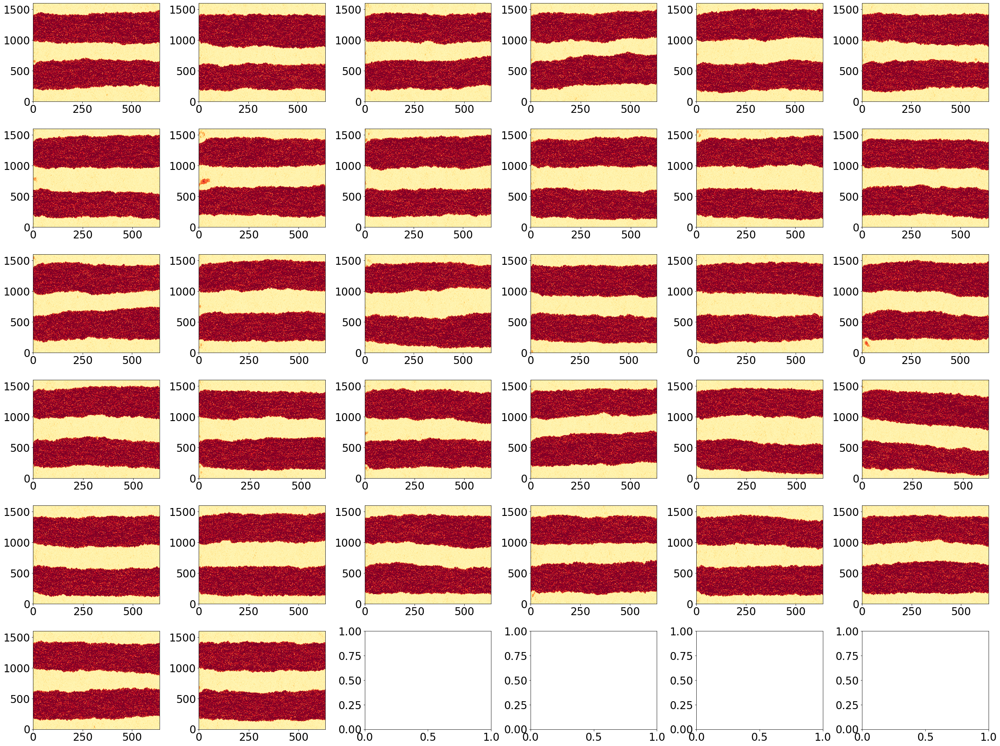

In [7]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin5um_2xKe30_ks100_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))
graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()

This is not what I was hoping for. These condensates look remarkably stable. The only way I could maybe get this to work is if I change the size of the condensates I think. This would require changing the size of one of the condensates to start with but I guess that actually is a fair question that someone would ask in the review. So let me try to run one of those simulations sweeps. Also I wonder what would happen if I just brought the condensates closer together.

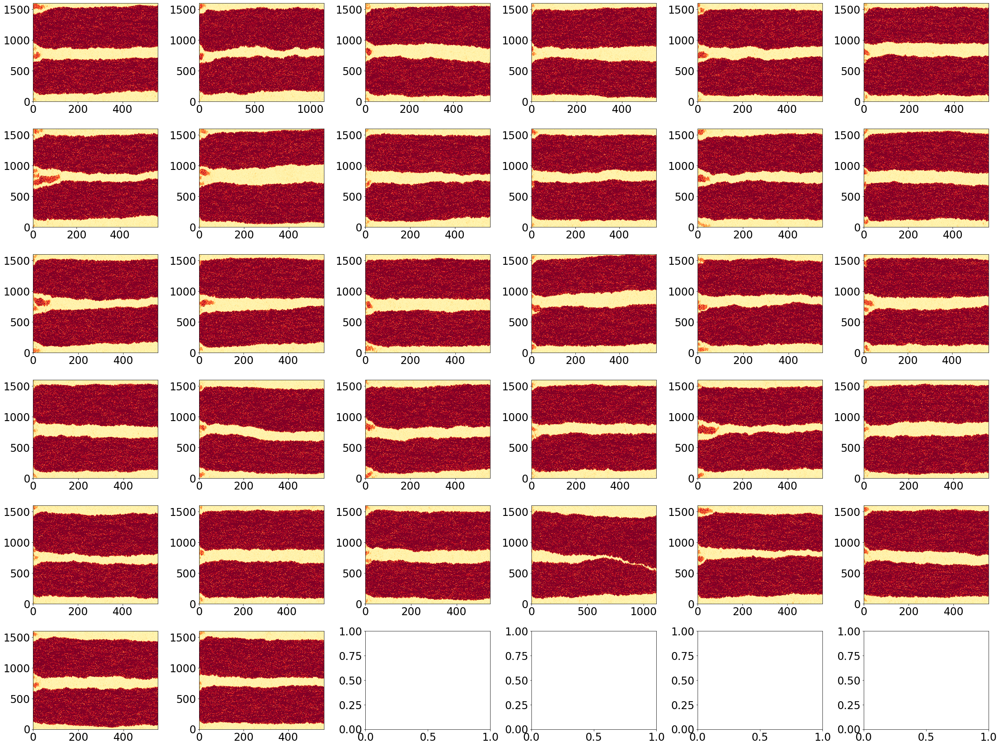

In [6]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin3um_2xKe30_ks100_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))
graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()

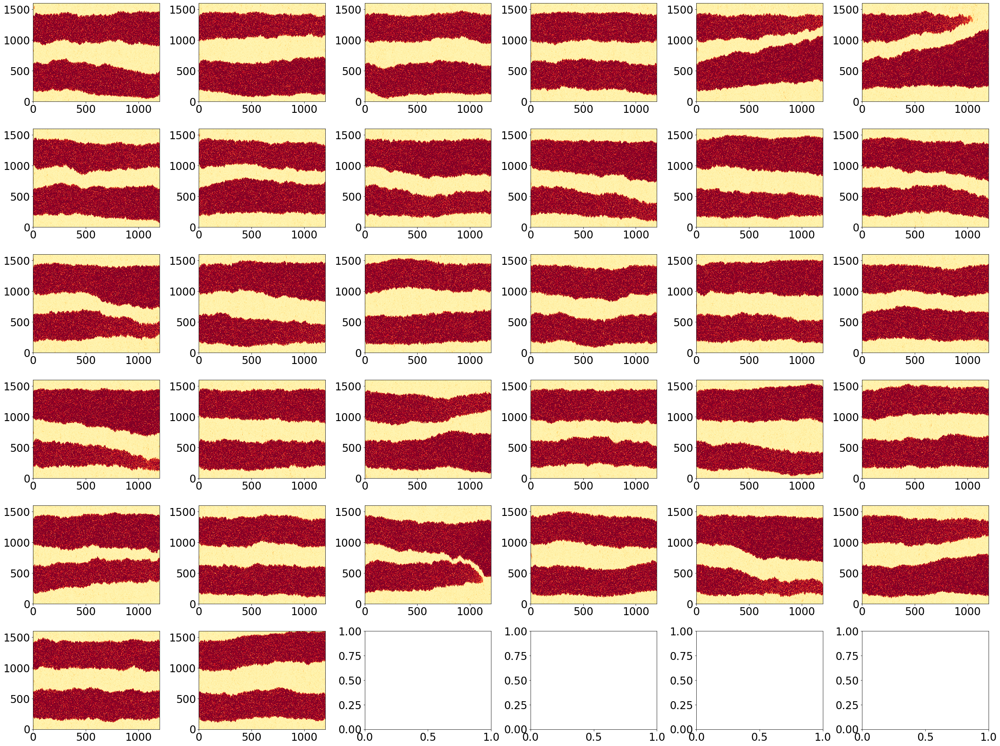

In [5]:
data_path = ceph_path / "DynCondPaper/24-02-30_aLc1_scan.32_line1600_Pin5um_2xKe30_ks100_kod300_2patch_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))
graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()

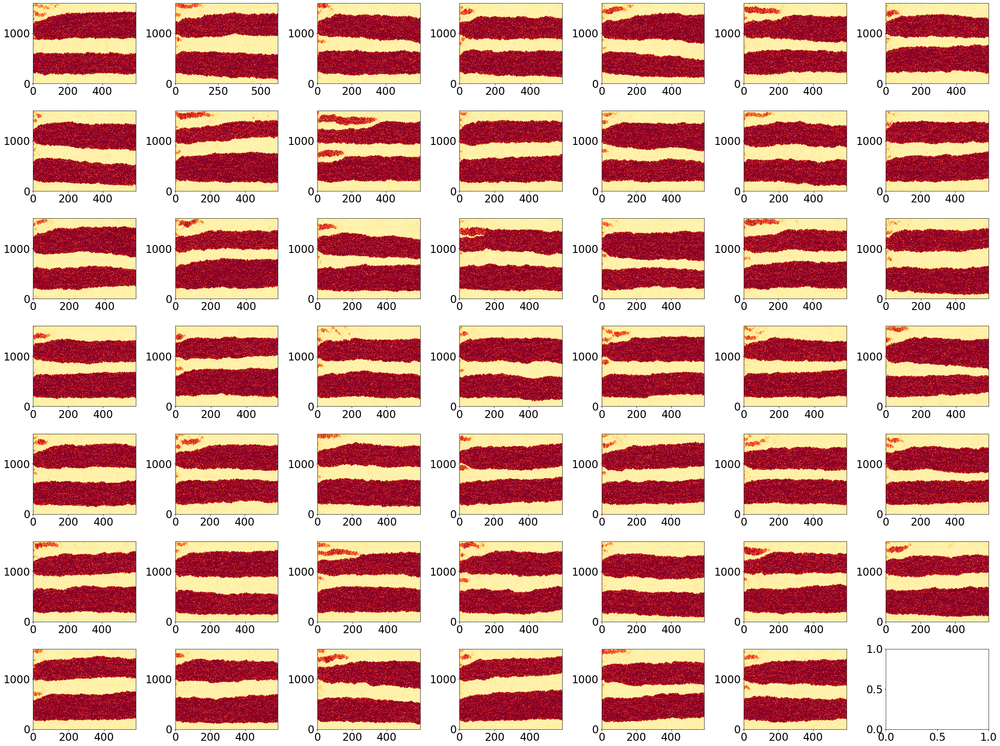

In [6]:
data_path = ceph_path / "DynCondPaper/24-03-07_aLc1_scan.32_line1600_Pin5um_2xKe30_ks100_2patch100-200_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))
graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


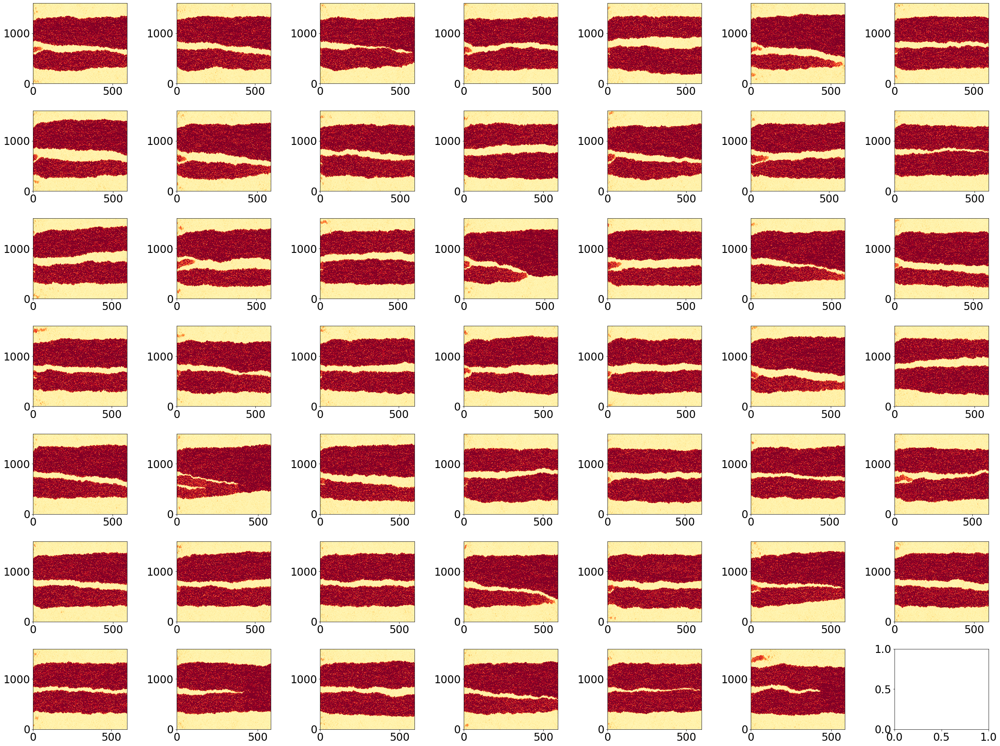

In [4]:
data_path = ceph_path / "DynCondPaper/24-03-07_aLc1_scan.48_line1600_Pin5um_2xKe30_ks100_2patch_sep100_equil"
h5_list = list(data_path.glob('simulations/*/analysis/contact_analysis.h5'))
graph_side_length = int(np.ceil(np.sqrt(len(h5_list))))

fig, axarr = plt.subplots(graph_side_length, graph_side_length, figsize=(32, 24))
for i in range(graph_side_length):
    for j in range(graph_side_length):
        if i*graph_side_length + j >= len(h5_list):
            break
        try: 
            with h5py.File(h5_list[i*graph_side_length + j], 'r') as h5_data:

                time_arr = h5_data['time'][...]
                contact_kymo = h5_data['contact_kymo'][...]

            cgf.plot_contact_kymo(fig, axarr[i,j], time_arr, 
                                    contact_kymo, vmax=vmax, label_flag=False)
        except:
            pass
fig.tight_layout()